In [1]:
import pandas as pd
import numpy as np
from pyarrow import Table
import pyarrow.dataset as ds
import pyarrow.compute as pc
import pyarrow.parquet as pq
import matplotlib.pyplot as plt
from source import *
from pathlib import Path

import scienceplots

plt.style.use(['science','ieee', 'grid'])
prop_cycle = plt.rcParams['axes.prop_cycle']
colors = prop_cycle.by_key()['color']

In [2]:
sig = ds.dataset(list(Path(f"new_sig/").glob("*.parquet")), format="parquet")

In [3]:
lep = ds.dataset(list(Path(f"halfleptonic/").glob("*.parquet")), format="parquet")

In [4]:
scanner = lep.scanner(batch_size=100_000)
for batch in scanner.to_batches():
    table = Table.from_batches([batch])
    display(table.to_pandas().columns)
    break
del scanner

Index(['__experiment__', '__run__', '__event__', '__production__', 'pcm',
       'ecm', 'missedE', 'recM2_Ups', 'cmpmiss', 'cmpmiss_ROE', 'cmthetamiss',
       'cmthetamiss_ROE', 'fox_ups', 'fox_Btag', 'asymmetry', 'pBtag',
       'theta_Btag', 'MBtag', 'rec_theta_Btag', 'idec0', 'idec1', 'is0',
       'N_KL', 'Miss_id_0', 'Miss_id_1', 'Bs_lik', 'N_KS', 'theta_tau_0',
       'p_tau_0', 'theta_tau_1', 'p_tau_1', 'p_tau_0_tagcm', 'p_tau_1_tagcm',
       'ang_taus', 'ang_taus_tagcm', 'ang_tau0_pmiss', 'ang_tau1_pmiss',
       'ang_tau1_ROE', 'ang_tau0_ROE', 'Delta_tau1_Btag', 'Delta_tau0_Btag',
       'tau_d_0_0', 'tau_d_1_0', 'tau_last_z_0', 'tau_last_r_0',
       'tau_last_z_1', 'tau_last_r_1', 'Istau0', 'Istau1', 'Chi_sq_0',
       'Chi_sq_1', 'dr0', 'dr1', 'totalEnergyMC', 'E_gamma_in_ROE',
       'correct_nu_0', 'correct_nu_1', 'correct_gamma_0', 'correct_gamma_1',
       'lost_0', 'lost_1', 'PID_self_vs_0_tau0', 'PID_self_vs_1_tau0',
       'PID_self_vs_2_tau0', 'PID_self_vs_4_tau0'

In [5]:
scanner = sig.scanner(batch_size=100_000)
for batch in scanner.to_batches():
    table = Table.from_batches([batch])
    display(table.to_pandas().columns)
    break
del scanner

Index(['__experiment__', '__run__', '__event__', '__production__', 'pcm',
       'ecm', 'missedE', 'recM2_Ups', 'cmpmiss', 'cmpmiss_ROE', 'cmthetamiss',
       'cmthetamiss_ROE', 'fox_ups', 'fox_Btag', 'asymmetry', 'pBtag',
       'theta_Btag', 'MBtag', 'rec_theta_Btag', 'idec0', 'idec1', 'is0',
       'N_KL', 'Miss_id_0', 'Miss_id_1', 'Bs_lik', 'N_KS', 'theta_tau_0',
       'p_tau_0', 'theta_tau_1', 'p_tau_1', 'p_tau_0_tagcm', 'p_tau_1_tagcm',
       'ang_taus', 'ang_taus_tagcm', 'ang_tau0_pmiss', 'ang_tau1_pmiss',
       'ang_tau1_ROE', 'ang_tau0_ROE', 'Delta_tau1_Btag', 'Delta_tau0_Btag',
       'tau_d_0_0', 'tau_d_1_0', 'tau_last_z_0', 'tau_last_r_0',
       'tau_last_z_1', 'tau_last_r_1', 'Istau0', 'Istau1', 'Chi_sq_0',
       'Chi_sq_1', 'dr0', 'dr1', 'totalEnergyMC', 'E_gamma_in_ROE',
       'correct_nu_0', 'correct_nu_1', 'correct_gamma_0', 'correct_gamma_1',
       'lost_0', 'lost_1', 'PID_self_vs_0_tau0', 'PID_self_vs_1_tau0',
       'PID_self_vs_2_tau0', 'PID_self_vs_4_tau0'

In [5]:
decay_mod_tau = ["$e^+ \\nu_e \\bar \\nu_\\tau$", "$\mu^+ \\nu_\\mu \\bar \\nu_\\tau$", "$\\pi^+ \\bar \\nu_\\tau$", "$\\rho^+ (\\pi^+ \\pi^0) \\bar \\nu_\\tau$", "$\\pi^+ \\pi^+ \\pi^- \\bar \\nu_\\tau$", "$\\rho^+ (\\pi^+ \\gamma) \\bar \\nu_\\tau$"]
mask = (pc.field("E_gamma_in_ROE") < 1.2) & (pc.field("Bs_lik") > 0.0012) & (pc.field("N_KS") < 0.5)
mask_M = (pc.field("M0") > 5.347) &  (pc.field("M0") < 5.387) 
mask1 = (pc.field("E_gamma_in_ROE") < 1.2) & (pc.field("is0") == 1) & (pc.field("Bs_lik") > 0.0012) &  (pc.field("M0") > 5.347) &  (pc.field("M0") < 5.387) 
mask0 = (pc.field("E_gamma_in_ROE") < 1.2) & (pc.field("is0") == 0) & (pc.field("Bs_lik") > 0.0012) &  (pc.field("M0") > 5.347) &  (pc.field("M0") < 5.387)
mask_is1 = pc.field("correct_nu_0") & pc.field("correct_nu_1") & pc.field("correct_gamma_0") & pc.field("correct_gamma_1") & pc.field("lost_0") & pc.field("lost_1") & pc.field("Miss_id_0") & pc.field("Miss_id_1")
mask_is0 = pc.field("is0") == 1
mask_lep = ((pc.field("idec0") == 0) | (pc.field("idec0") == 1)) & ((pc.field("idec1") == 0) | (pc.field("idec1") == 1))
mask_miss_id = pc.field("Miss_id_0") & pc.field("Miss_id_1")
mask_lost_Kpi = pc.field("lost_0") & pc.field("lost_1")
mask_KS_veto = (pc.field("N_KS") == 0) & (pc.field("N_KL") == 0)

<>:1: SyntaxWarning: invalid escape sequence '\m'
<>:1: SyntaxWarning: invalid escape sequence '\m'
C:\Users\matve\AppData\Local\Temp\ipykernel_9832\2208745519.py:1: SyntaxWarning: invalid escape sequence '\m'
  decay_mod_tau = ["$e^+ \\nu_e \\bar \\nu_\\tau$", "$\mu^+ \\nu_\\mu \\bar \\nu_\\tau$", "$\\pi^+ \\bar \\nu_\\tau$", "$\\rho^+ (\\pi^+ \\pi^0) \\bar \\nu_\\tau$", "$\\pi^+ \\pi^+ \\pi^- \\bar \\nu_\\tau$", "$\\rho^+ (\\pi^+ \\gamma) \\bar \\nu_\\tau$"]


In [6]:
mask_sig = mask_lep & (pc.field("is0") == 1) & mask_is1 & mask
mask_bkg = mask_lep & (pc.field("is0") == 1) & mask

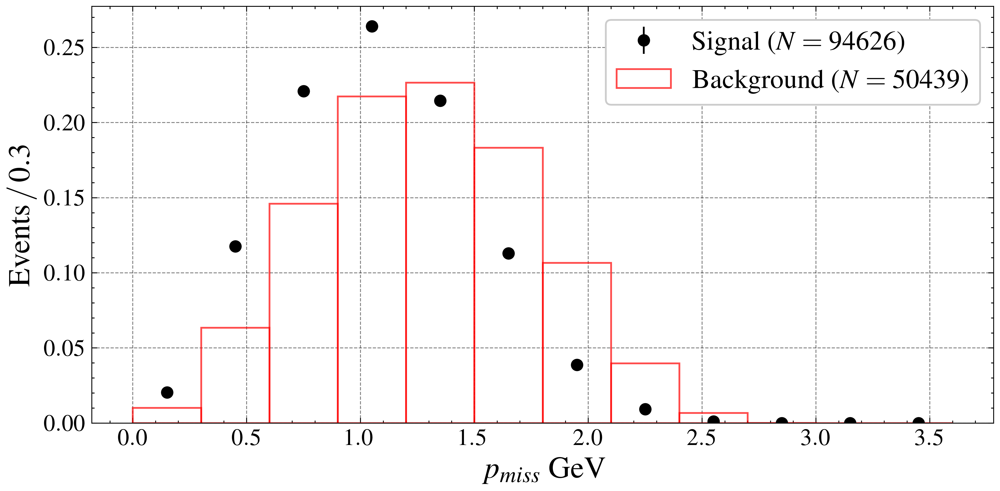

In [7]:
wbin = 0.3
a = 0
b = 3.6
bins = np.linspace(a, b, int((b-a)/wbin + 1))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))



bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, "cmpmiss",
    filter_mask=mask_sig
)
errordot(counts_sig, bins=bins, density=True, color=colors[0], label=f"Signal ($N = {N_sig}$)", )


# Background
bin_centers_lep, counts_lep, N_lep = compute_histogram(
    lep, bins, "cmpmiss",
    filter_mask=mask_bkg,
    norm=True
)
ax.bar(
    bin_centers_lep, counts_lep,
    yerr=np.sqrt(counts_lep)/N_lep,
    width=wbin, align='center',
    fill = False, alpha = 0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep}$)"
)


ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$p_{miss} \ \mathrm{GeV}$')
ax.legend()

plt.tight_layout()
plt.savefig("output/comp/cmpmiss.pdf")
plt.show()

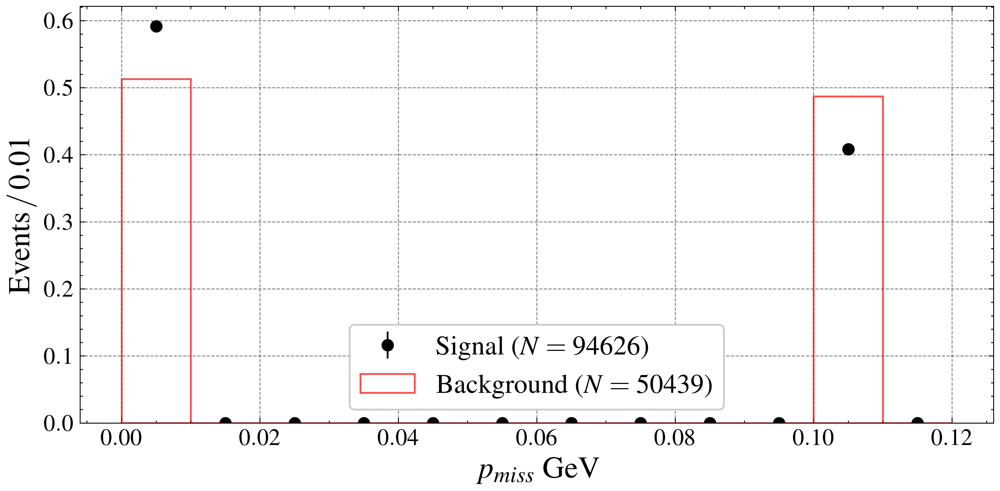

In [8]:
wbin = 0.01
a = 0
b = 0.12
bins = np.linspace(a, b, int((b-a)/wbin + 1))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))



bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, "tau_d_0_0",
    filter_mask=mask_sig
)
errordot(counts_sig, bins=bins, density=True, color=colors[0], label=f"Signal ($N = {N_sig}$)", )


# Background
bin_centers_lep, counts_lep, N_lep = compute_histogram(
    lep, bins, "tau_d_0_0",
    filter_mask=mask_bkg,
    norm=True
)
ax.bar(
    bin_centers_lep, counts_lep,
    yerr=np.sqrt(counts_lep)/N_lep,
    width=wbin, align='center',
    fill = False, alpha = 0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep}$)"
)


ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$p_{miss} \ \mathrm{GeV}$')
ax.legend()

plt.tight_layout()
plt.show()

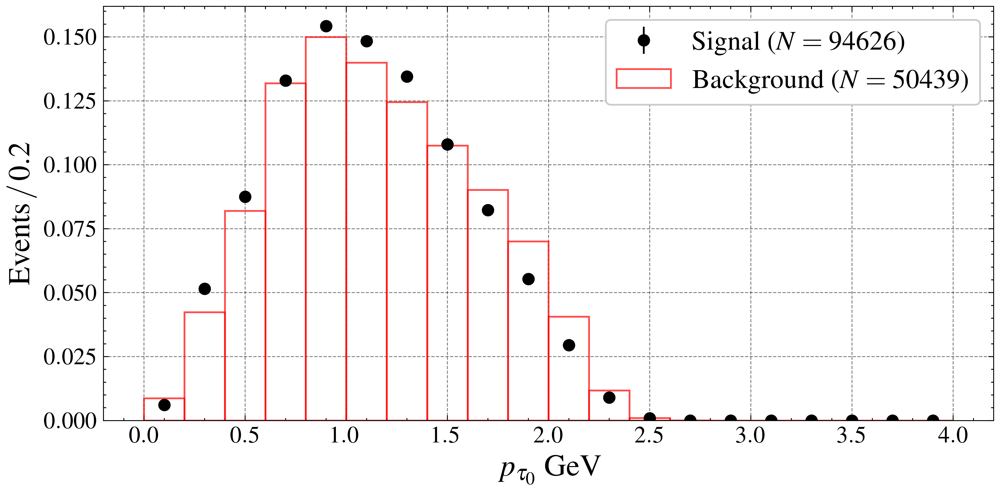

In [9]:
wbin = 0.2
a = 0
b = 4
bins = np.linspace(a, b, int((b-a)/wbin + 1))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))



bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, "p_tau_0",
    filter_mask=mask_sig
)
errordot(counts_sig, bins=bins, density=True, color=colors[0], label=f"Signal ($N = {N_sig}$)", )


# Background
bin_centers_lep, counts_lep, N_lep = compute_histogram(
    lep, bins, "p_tau_0",
    filter_mask=mask_bkg,
    norm=True
)
ax.bar(
    bin_centers_lep, counts_lep,
    yerr=np.sqrt(counts_lep)/N_lep,
    width=wbin, align='center',
    fill = False, alpha = 0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$p_{\tau_0} \ \mathrm{GeV}$')
ax.legend()

plt.savefig("output/comp/p_tau_0.pdf")
plt.tight_layout()
plt.show()

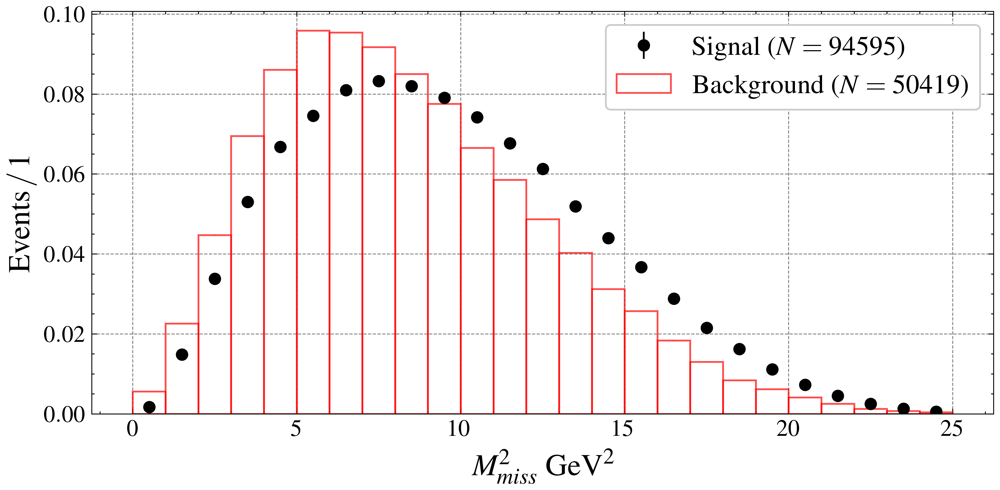

In [10]:
wbin = 1
a = 0
b = 25
bins = np.linspace(a, b, int((b-a)/wbin + 1))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))



bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, "recM2_Ups",
    filter_mask=mask_sig,
)
errordot(counts_sig, bins=bins, density=True, color=colors[0], label=f"Signal ($N = {N_sig}$)", )


# Background
bin_centers_lep, counts_lep, N_lep = compute_histogram(
    lep, bins, "recM2_Ups",
    filter_mask=mask_bkg,
    norm=True
)
ax.bar(
    bin_centers_lep, counts_lep,
    yerr=np.sqrt(counts_lep)/N_lep,
    width=wbin, align='center',
    fill = False, alpha = 0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep}$)"
)


ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$M^2_{miss} \ \mathrm{GeV}^2$')
ax.legend()

plt.tight_layout()
plt.savefig("output/comp/m2_miss.pdf")
plt.show()

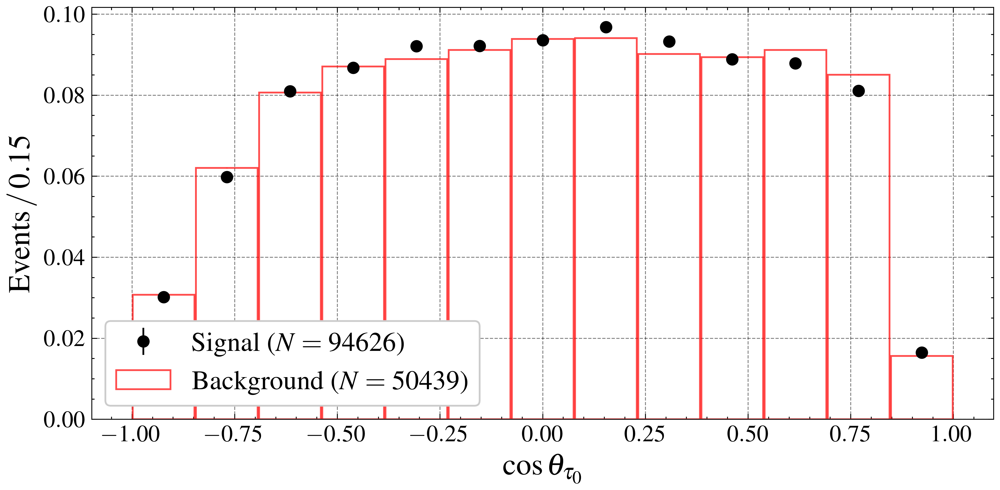

In [11]:
wbin = 0.15
a = -1
b = 1
bins = np.linspace(a, b, int((b - a) / wbin + 1))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))

# Signal
bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, "theta_tau_0",
    filter_mask=mask_sig,
    norm=False
)
errordot(counts_sig, bins=bins, density=True, color=colors[0], label=f"Signal ($N = {N_sig}$)", axs=ax)

# Background
bin_centers_lep, counts_lep, N_lep = compute_histogram(
    lep, bins, "theta_tau_0",
    filter_mask=mask_bkg,
    norm=True
)
ax.bar(
    bin_centers_lep, counts_lep,
    yerr=np.sqrt(counts_lep) / N_lep,
    width=wbin, align='center',
    fill=False, alpha=0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$\cos \theta_{\tau_0}$')
ax.legend()

plt.tight_layout()
plt.show()


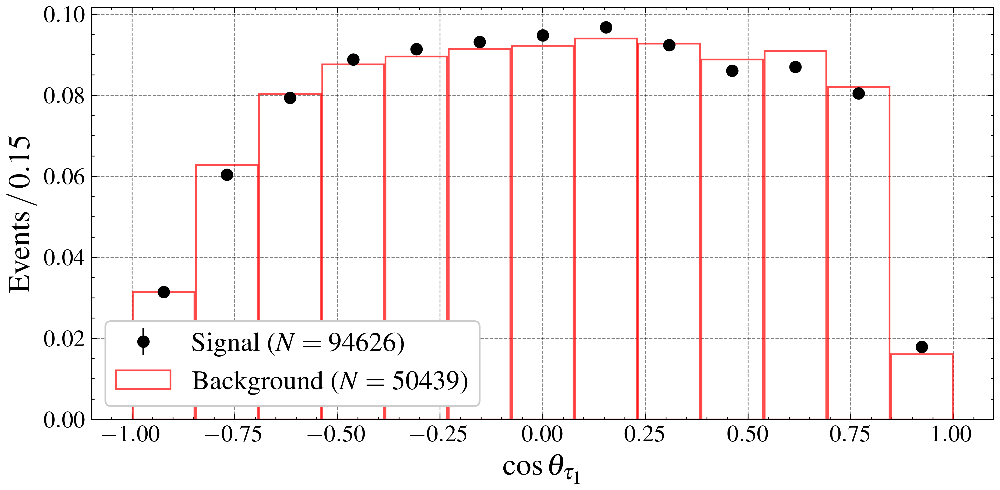

In [12]:
wbin = 0.15
a = -1
b = 1
bins = np.linspace(a, b, int((b - a) / wbin + 1))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))

# Signal
bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, "theta_tau_1",
    filter_mask=mask_sig,
    norm=False
)
errordot(counts_sig, bins=bins, density=True, color=colors[0], label=f"Signal ($N = {N_sig}$)", axs=ax)

# Background
bin_centers_lep, counts_lep, N_lep = compute_histogram(
    lep, bins, "theta_tau_1",
    filter_mask=mask_bkg,
    norm=True
)
ax.bar(
    bin_centers_lep, counts_lep,
    yerr=np.sqrt(counts_lep) / N_lep,
    width=wbin, align='center',
    fill=False, alpha=0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$\cos \theta_{\tau_1}$')
ax.legend()

plt.tight_layout()
plt.show()


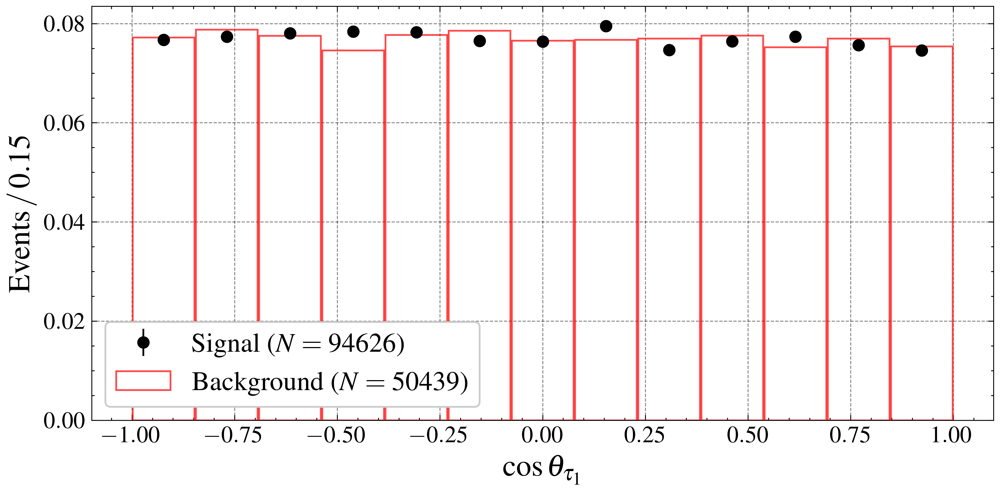

In [13]:
wbin = 0.15
a = -1
b = 1
bins = np.linspace(a, b, int((b - a) / wbin + 1))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))

# Signal
bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, "theta_Btag",
    filter_mask=mask_sig,
    norm=False
)
errordot(counts_sig, bins=bins, density=True, color=colors[0], label=f"Signal ($N = {N_sig}$)", axs=ax)

# Background
bin_centers_lep, counts_lep, N_lep = compute_histogram(
    lep, bins, "theta_Btag",
    filter_mask=mask_bkg,
    norm=True
)
ax.bar(
    bin_centers_lep, counts_lep,
    yerr=np.sqrt(counts_lep) / N_lep,
    width=wbin, align='center',
    fill=False, alpha=0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$\cos \theta_{\tau_1}$')
ax.legend()

plt.tight_layout()
plt.show()


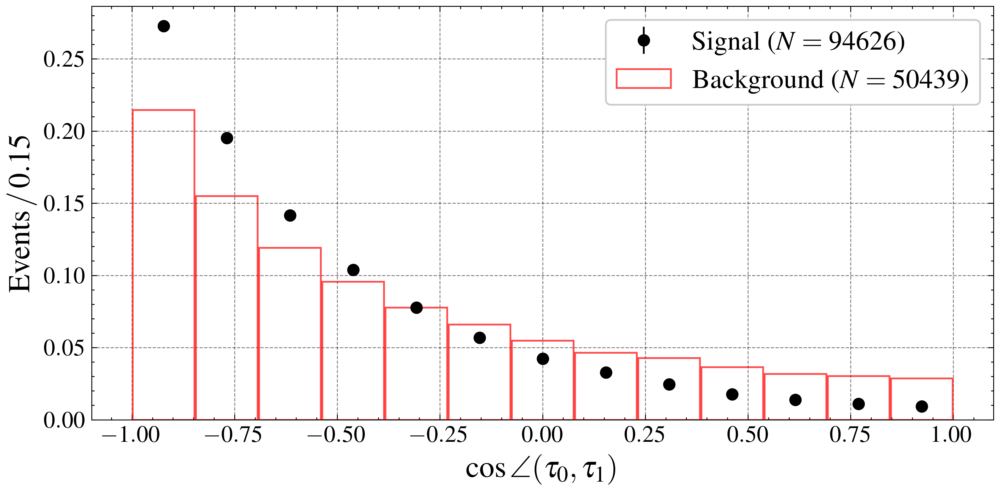

In [14]:
wbin = 0.15
a = -1
b = 1
bins = np.linspace(a, b, int((b - a) / wbin + 1))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))

# Signal: cos(angle between tau0 and tau1)
bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, "ang_taus",
    filter_mask=mask_sig,
    norm=False
)
errordot(counts_sig, bins=bins, density=True, color=colors[0], label=f"Signal ($N = {N_sig}$)", axs=ax)

# Background
bin_centers_lep, counts_lep, N_lep = compute_histogram(
    lep, bins, "ang_taus",
    filter_mask=mask_bkg,
    norm=True
)
ax.bar(
    bin_centers_lep, counts_lep,
    yerr=np.sqrt(counts_lep) / N_lep,
    width=wbin, align='center',
    fill=False, alpha=0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$\cos \angle(\tau_0, \tau_1)$')
ax.legend()
plt.tight_layout()
plt.savefig("output/comp/ang_taus.pdf")
plt.show()


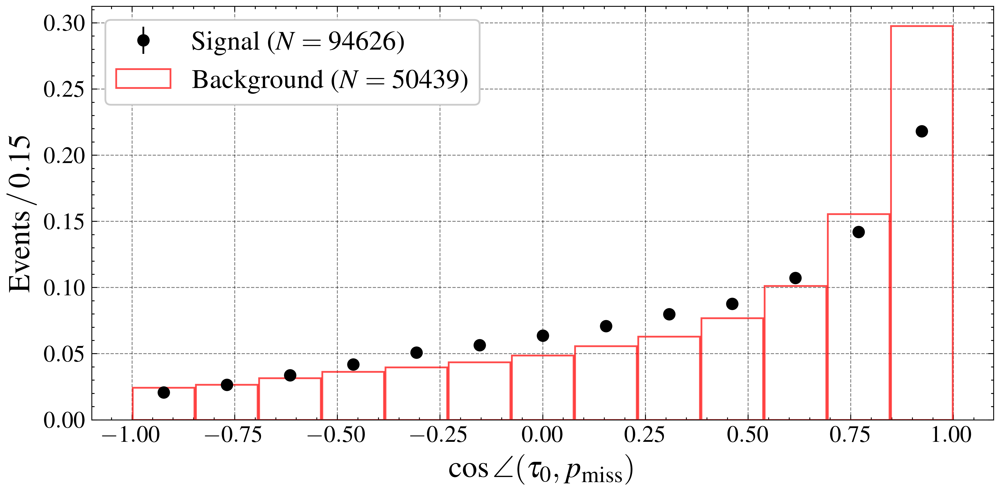

In [15]:
# --- For ang_tau0_pmiss ---
fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))

bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, "ang_tau0_pmiss",
    filter_mask=mask_sig,
    norm=False
)
errordot(counts_sig, bins=bins, density=True, color=colors[0], label=f"Signal ($N = {N_sig}$)", axs=ax)

bin_centers_lep, counts_lep, N_lep = compute_histogram(
    lep, bins, "ang_tau0_pmiss",
    filter_mask=mask_bkg,
    norm=True
)
ax.bar(
    bin_centers_lep, counts_lep,
    yerr=np.sqrt(counts_lep) / N_lep,
    width=wbin, align='center',
    fill=False, alpha=0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$\cos \angle(\tau_0, p_\mathrm{miss})$')
ax.legend()
plt.tight_layout()
plt.savefig("output/comp/ang_tau0_pmiss.pdf")
plt.show()


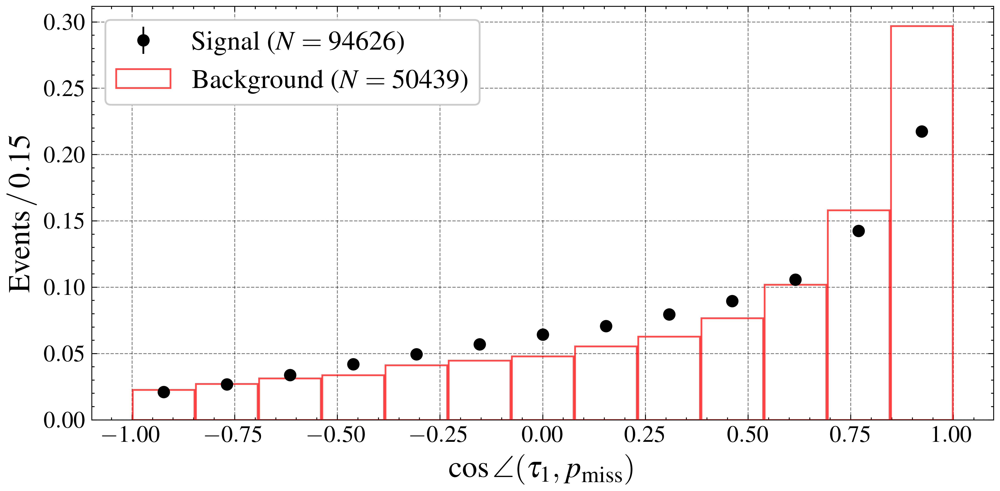

In [16]:
# --- For ang_tau1_pmiss ---
fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))

bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, "ang_tau1_pmiss",
    filter_mask=mask_sig,
    norm=False
)
errordot(counts_sig, bins=bins, density=True, color=colors[0], label=f"Signal ($N = {N_sig}$)", axs=ax)

bin_centers_lep, counts_lep, N_lep = compute_histogram(
    lep, bins, "ang_tau1_pmiss",
    filter_mask=mask_bkg,
    norm=True
)
ax.bar(
    bin_centers_lep, counts_lep,
    yerr=np.sqrt(counts_lep) / N_lep,
    width=wbin, align='center',
    fill=False, alpha=0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$\cos \angle(\tau_1, p_\mathrm{miss})$')
ax.legend()
plt.tight_layout()
plt.show()


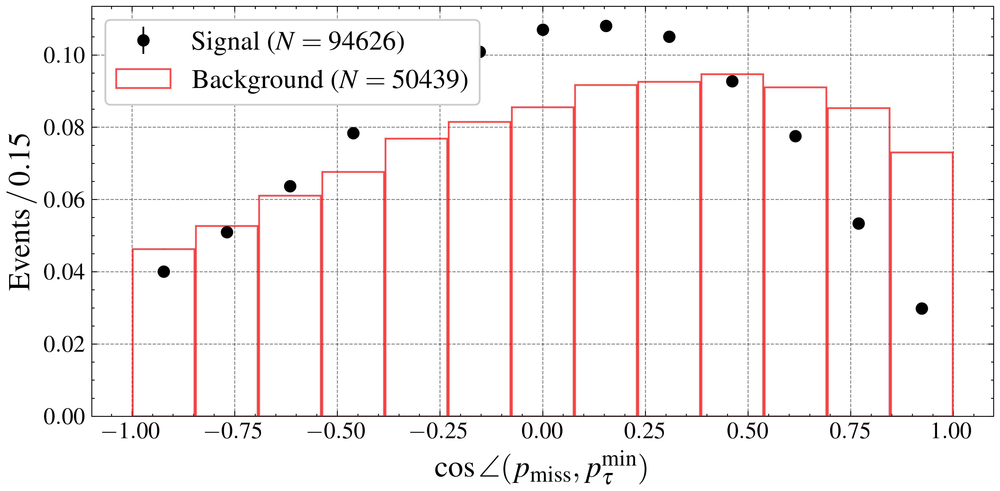

In [17]:
wbin = 0.15
a = -1
b = 1
bins = np.linspace(a, b, int((b - a) / wbin + 1))

fig, ax = plt.subplots(1, figsize=(12 / 1.5, 6 / 1.5))

# функция выбора угла с наиболее энергичным лептоном
def select_max_energy_angle(df):
    return pd.DataFrame({
        "cos_angle": np.where(
            df["p_tau_0"] > df["p_tau_1"],
            df["ang_tau1_pmiss"],
            df["ang_tau0_pmiss"]
        )
    })

# Signal
bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, target="cos_angle",
    fun=select_max_energy_angle,
    filter_mask=mask_sig,
    norm=False
)
errordot(counts_sig, bins=bins, density=True,
         color=colors[0], label=f"Signal ($N = {N_sig}$)", axs=ax)

# Background
bin_centers_lep, counts_lep, N_lep = compute_histogram(
    lep, bins, target="cos_angle",
    fun=select_max_energy_angle,
    filter_mask=mask_bkg,
    norm=True
)
ax.bar(
    bin_centers_lep, counts_lep,
    yerr=np.sqrt(counts_lep) / N_lep,
    width=wbin, align='center',
    fill=False, alpha=0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$\cos \angle(p_\mathrm{miss}, p_{\tau}^{\min})$')
ax.legend()
plt.tight_layout()
plt.show()


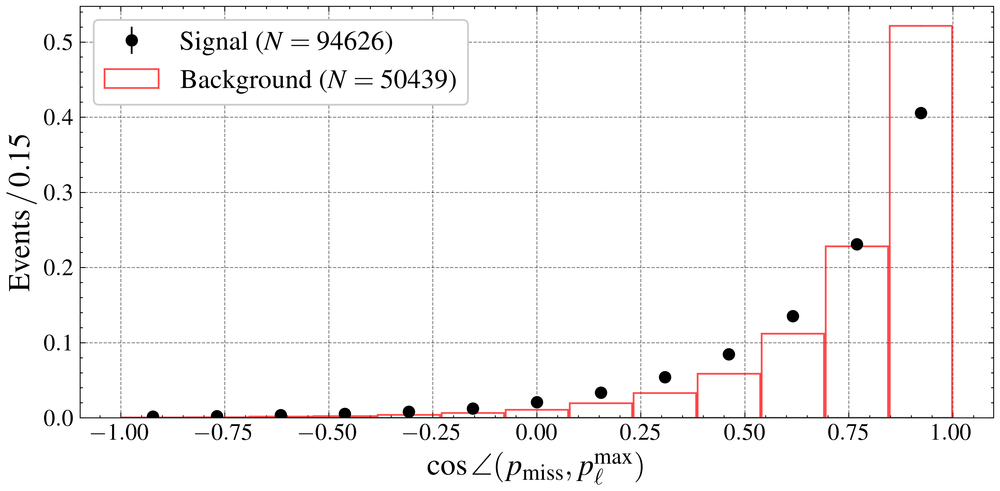

In [18]:
wbin = 0.15
a = -1
b = 1
bins = np.linspace(a, b, int((b - a) / wbin + 1))

fig, ax = plt.subplots(1, figsize=(12 / 1.5, 6 / 1.5))

# функция выбора угла с наиболее энергичным лептоном
def select_max_energy_angle(df):
    return pd.DataFrame({
        "cos_angle": np.where(
            df["p_tau_0"] > df["p_tau_1"],
            df["ang_tau0_pmiss"],
            df["ang_tau1_pmiss"]
        )
    })

# Signal
bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, target="cos_angle",
    fun=select_max_energy_angle,
    filter_mask=mask_sig,
    norm=False
)
errordot(counts_sig, bins=bins, density=True,
         color=colors[0], label=f"Signal ($N = {N_sig}$)", axs=ax)

# Background
bin_centers_lep, counts_lep, N_lep = compute_histogram(
    lep, bins, target="cos_angle",
    fun=select_max_energy_angle,
    filter_mask=mask_bkg,
    norm=True
)
ax.bar(
    bin_centers_lep, counts_lep,
    yerr=np.sqrt(counts_lep) / N_lep,
    width=wbin, align='center',
    fill=False, alpha=0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$\cos \angle(p_\mathrm{miss}, p_{\ell}^{\max})$')
ax.legend()
plt.tight_layout()
plt.show()


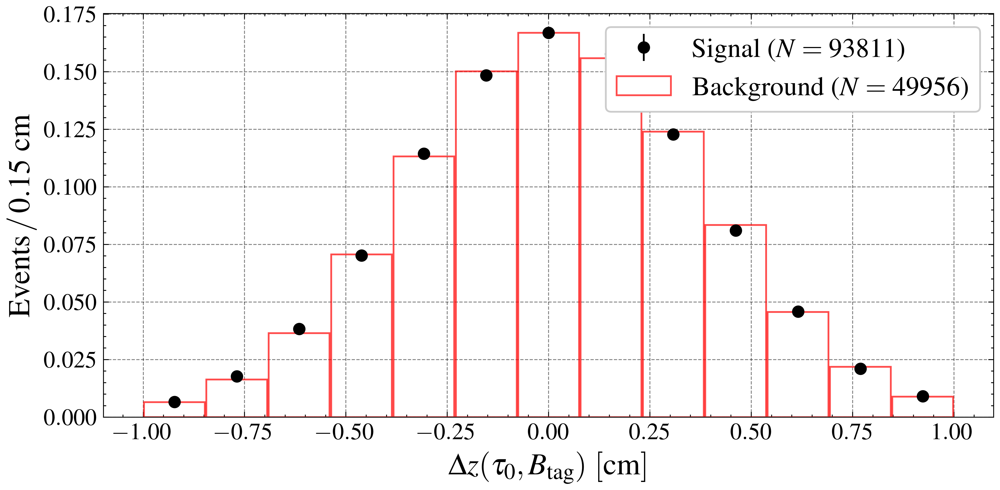

In [19]:
fig, ax = plt.subplots(1, figsize=(12 / 1.5, 6 / 1.5))

bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, target="Delta_tau0_Btag",
    filter_mask=mask_sig,
    norm=False
)
errordot(counts_sig, bins=bins, density=True,
         color=colors[0], label=f"Signal ($N = {N_sig}$)", axs=ax)

bin_centers_bkg, counts_bkg, N_bkg = compute_histogram(
    lep, bins, target="Delta_tau0_Btag",
    filter_mask=mask_bkg,
    norm=True
)
ax.bar(
    bin_centers_bkg, counts_bkg,
    yerr=np.sqrt(counts_bkg) / N_bkg,
    width=wbin, align='center',
    fill=False, alpha=0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_bkg}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}\\ \\mathrm{{cm}}$')
ax.set_xlabel(r'$\Delta z(\tau_0, B_\mathrm{tag})\ \mathrm{[cm]}$')
ax.legend()
plt.tight_layout()
plt.show()


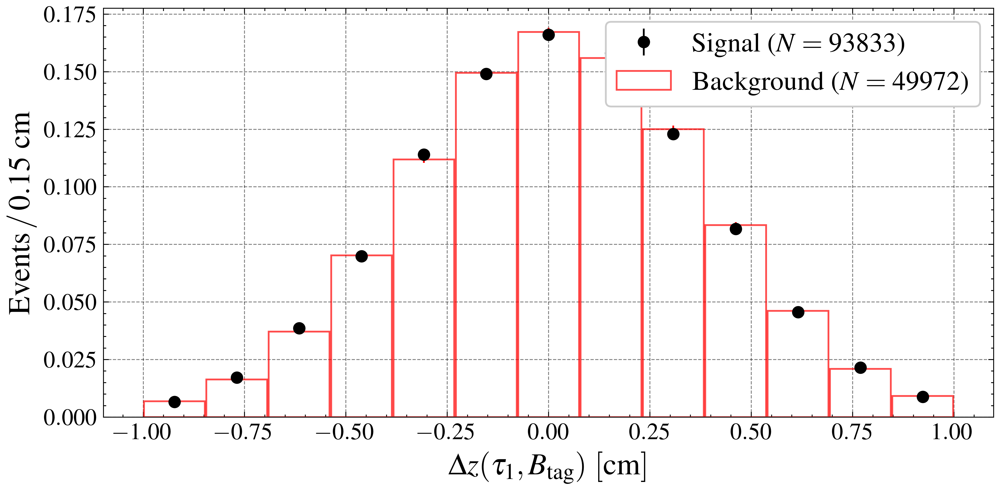

In [20]:
fig, ax = plt.subplots(1, figsize=(12 / 1.5, 6 / 1.5))

bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, target="Delta_tau1_Btag",
    filter_mask=mask_sig,
    norm=False
)
errordot(counts_sig, bins=bins, density=True,
         color=colors[0], label=f"Signal ($N = {N_sig}$)", axs=ax)

bin_centers_bkg, counts_bkg, N_bkg = compute_histogram(
    lep, bins, target="Delta_tau1_Btag",
    filter_mask=mask_bkg,
    norm=True
)
ax.bar(
    bin_centers_bkg, counts_bkg,
    yerr=np.sqrt(counts_bkg) / np.sqrt(N_bkg),
    width=wbin, align='center',
    fill=False, alpha=0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_bkg}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}\\ \\mathrm{{cm}}$')
ax.set_xlabel(r'$\Delta z(\tau_1, B_\mathrm{tag})\ \mathrm{[cm]}$')
ax.legend()
plt.tight_layout()
plt.show()


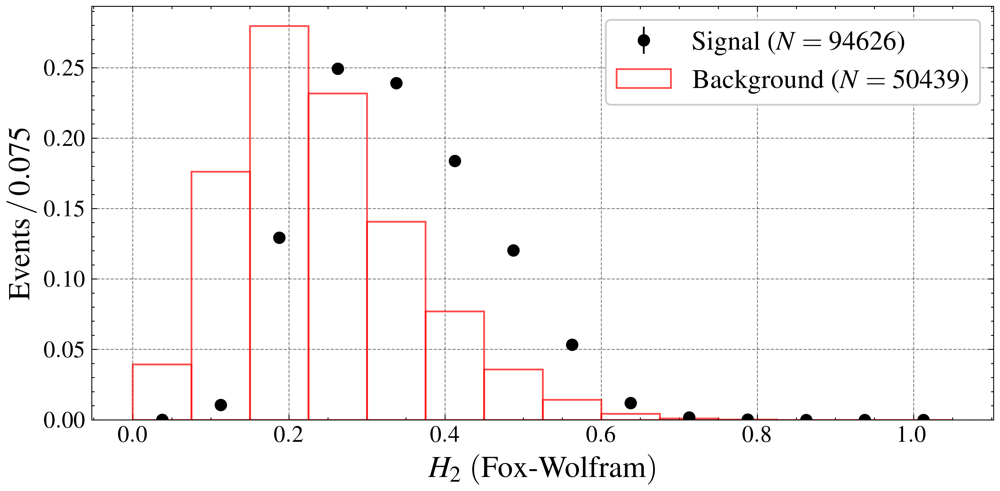

In [21]:
wbin = 0.075
a = 0
b = 1.05
bins = np.linspace(a, b, int((b - a) / wbin + 1))

fig, ax = plt.subplots(1, figsize=(12 / 1.5, 6 / 1.5))

# Signal
bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, "fox",
    filter_mask=mask_sig,
    norm=False
)
errordot(counts_sig, bins=bins, density=True,
         color=colors[0], label=f"Signal ($N = {N_sig}$)", axs=ax)

# Background
bin_centers_bkg, counts_bkg, N_bkg = compute_histogram(
    lep, bins, "fox",
    filter_mask=mask_bkg,
    norm=True
)
ax.bar(
    bin_centers_bkg, counts_bkg,
    yerr=np.sqrt(counts_bkg) / N_bkg,
    width=wbin, align='center',
    fill=False, alpha=0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_bkg}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$H_2\ \mathrm{(Fox\text{-}Wolfram)}$')
ax.legend()

plt.tight_layout()
plt.savefig("output/comp/fox.pdf")
plt.show()


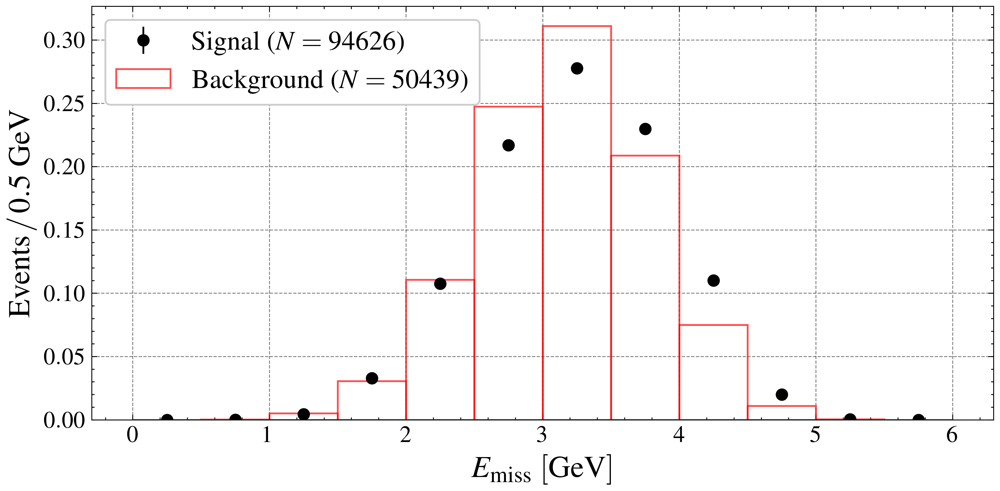

In [22]:
wbin = 0.5
a = 0
b = 6
bins = np.linspace(a, b, int((b - a) / wbin + 1))

fig, ax = plt.subplots(1, figsize=(12 / 1.5, 6 / 1.5))

# Signal
bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, "missedE",
    filter_mask=mask_sig,
    norm=False
)
errordot(counts_sig, bins=bins, density=True,
         color=colors[0], label=f"Signal ($N = {N_sig}$)", axs=ax)

# Background
bin_centers_bkg, counts_bkg, N_bkg = compute_histogram(
    lep, bins, "missedE",
    filter_mask=mask_bkg,
    norm=True
)
ax.bar(
    bin_centers_bkg, counts_bkg,
    yerr=np.sqrt(counts_bkg) / N_bkg,
    width=wbin, align='center',
    fill=False, alpha=0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_bkg}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}\\ \\mathrm{{GeV}}$')
ax.set_xlabel(r'$E_{\mathrm{miss}} \ \mathrm{[GeV]}$')
ax.legend()

plt.tight_layout()
plt.savefig("output/comp/missedE.pdf")
plt.show()


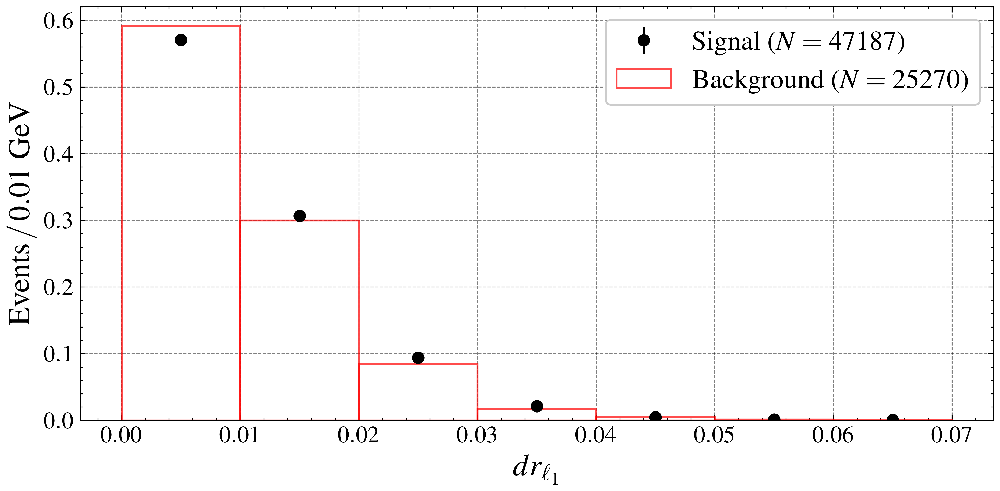

In [23]:
wbin = 0.01
a = 0
b = 0.07
bins = np.linspace(a, b, int((b - a) / wbin + 1))

fig, ax = plt.subplots(1, figsize=(12 / 1.5, 6 / 1.5))

# Signal
bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, "dr1",
    filter_mask=mask_sig & (pc.field("p_tau_0") < pc.field("p_tau_1")),
    norm=False
)
errordot(counts_sig, bins=bins, density=True,
         color=colors[0], label=f"Signal ($N = {N_sig}$)", axs=ax)

# Background
bin_centers_bkg, counts_bkg, N_bkg = compute_histogram(
    lep, bins, "dr1",
    filter_mask=mask_bkg & (pc.field("p_tau_0") < pc.field("p_tau_1")),
    norm=True
)
ax.bar(
    bin_centers_bkg, counts_bkg,
    yerr=np.sqrt(counts_bkg) / N_bkg,
    width=wbin, align='center',
    fill=False, alpha=0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_bkg}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}\\ \\mathrm{{GeV}}$')
ax.set_xlabel(r'$dr_{\ell_1}$')
ax.legend()

plt.tight_layout()
plt.savefig("output/comp/dr1.pdf")
plt.show()


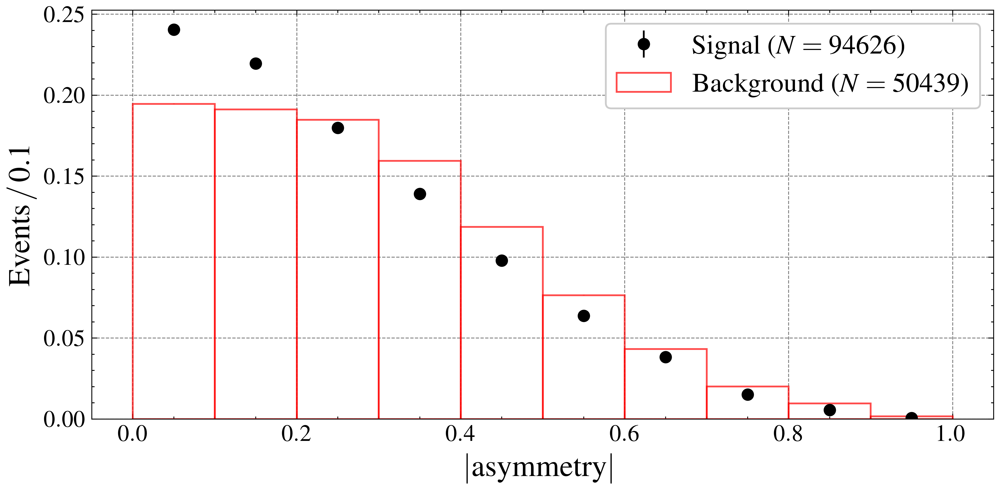

In [24]:
wbin = 0.1
a = 0
b = 1
bins = np.linspace(a, b, int((b - a) / wbin + 1))

fig, ax = plt.subplots(1, figsize=(12 / 1.5, 6 / 1.5))

# Signal
bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, "asymmetry", fun=lambda x: np.abs(x),
    filter_mask=mask_sig,
    norm=False
)
errordot(counts_sig, bins=bins, density=True,
         color=colors[0], label=f"Signal ($N = {N_sig}$)", axs=ax)

# Background
bin_centers_bkg, counts_bkg, N_bkg = compute_histogram(
    lep, bins, "asymmetry", fun=lambda x: np.abs(x),
    filter_mask=mask_bkg,
    norm=True
)
ax.bar(
    bin_centers_bkg, counts_bkg,
    yerr=np.sqrt(counts_bkg) / N_bkg,
    width=wbin, align='center',
    fill=False, alpha=0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_bkg}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$|\mathrm{asymmetry}|$')
ax.legend()

plt.tight_layout()
plt.savefig("output/comp/asymmetry.pdf")
plt.show()


In [25]:
bin_centers_sig = get_values(sig, ["p_tau_0", "p_tau_1"], filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1))

bin_centers_lep = get_values(lep, ["p_tau_0", "p_tau_1"], filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1))

Total data size: 0.51 MB
Total data size: 0.08 MB


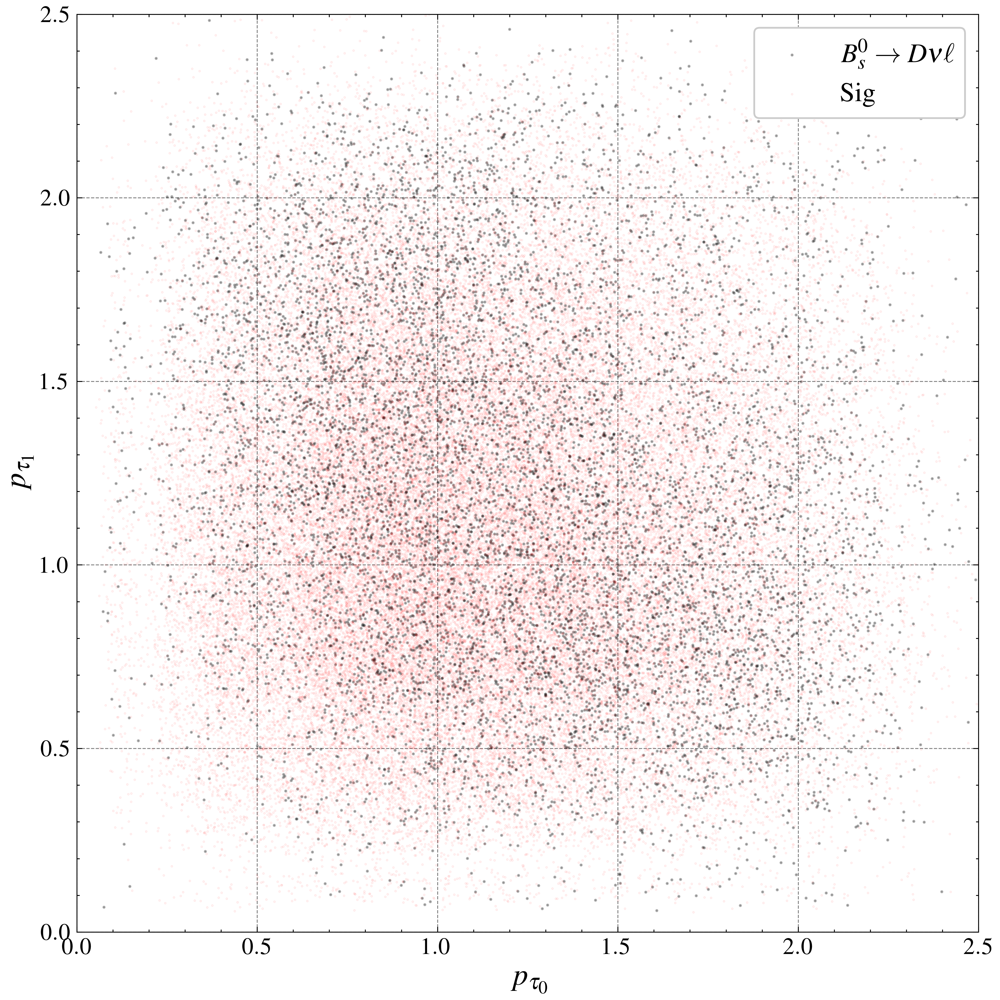

In [26]:
fig, ax = plt.subplots(1, figsize=(12/1.5, 12/1.5))

ax.scatter(bin_centers_lep.p_tau_0, bin_centers_lep.p_tau_1 , alpha=0.3, s=0.5, label = r"$B_s^0 \to D \nu \ell$")
ax.scatter(bin_centers_sig.p_tau_0, bin_centers_sig.p_tau_1, alpha=0.1, s=0.1, label = r"Sig")

ax.set_xlabel(r"$p_{\tau_0}$")
ax.set_ylabel(r"$p_{\tau_1}$")

ax.set_xlim(0,2.5)
ax.set_ylim(0,2.5)

ax.legend()

plt.tight_layout()
plt.show()


In [27]:
bin_centers_sig = get_values(sig, ["p_tau_0", "Chi_sq_0"], filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1))
bin_centers_sig1 = get_values(sig, ["p_tau_1", "Chi_sq_1"], filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1))



bin_centers_lep = get_values(lep, ["p_tau_0", "Chi_sq_0"], filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1))
bin_centers_lep1 = get_values(lep, ["p_tau_1", "Chi_sq_1"], filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1))

Total data size: 0.51 MB
Total data size: 0.51 MB
Total data size: 0.08 MB
Total data size: 0.08 MB


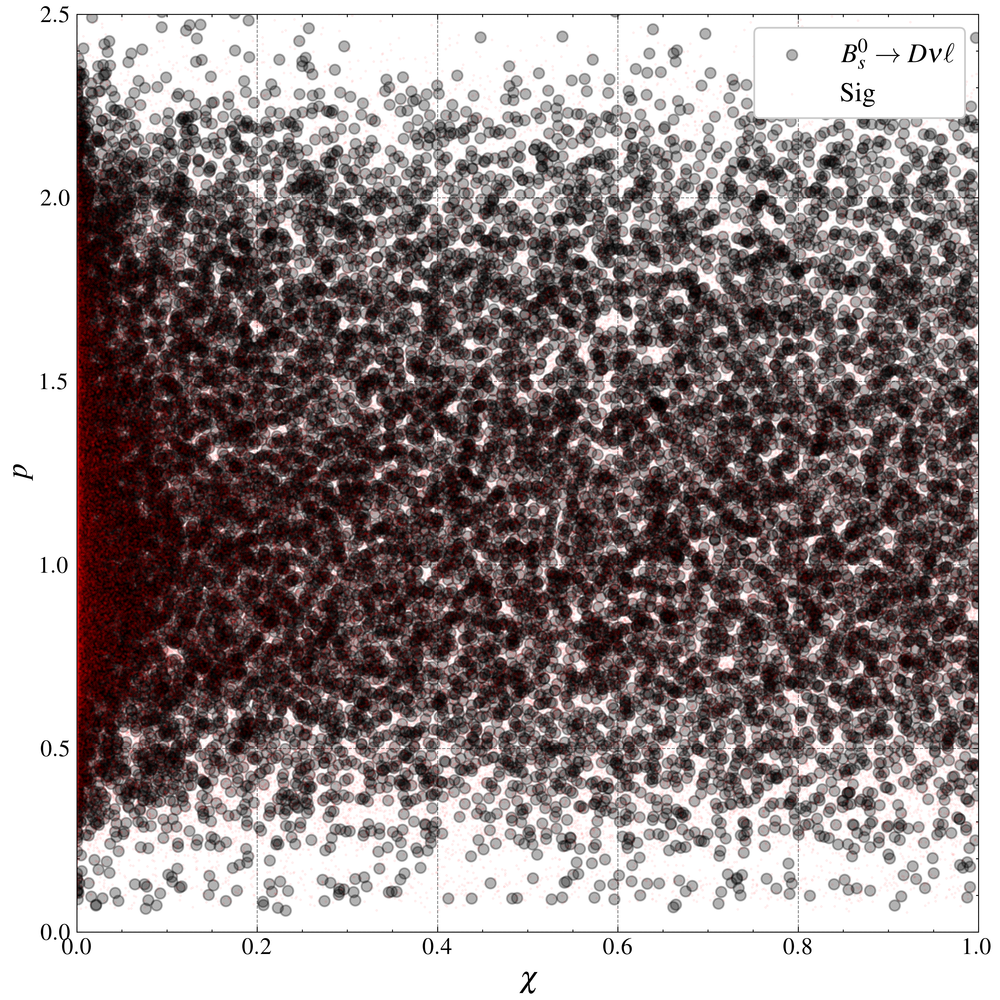

In [28]:
fig, ax = plt.subplots(1, figsize=(12/1.5, 12/1.5))

ax.scatter(np.concat([bin_centers_lep.Chi_sq_0, bin_centers_lep1.Chi_sq_1]), np.concat([bin_centers_lep.p_tau_0, bin_centers_lep1.p_tau_1]) , alpha=0.3, label = r"$B_s^0 \to D \nu \ell$")
ax.scatter(np.concat([bin_centers_sig.Chi_sq_0, bin_centers_sig1.Chi_sq_1]), np.concat([bin_centers_sig.p_tau_0, bin_centers_sig1.p_tau_1]), alpha=0.1, s=0.1, label = r"Sig")

ax.set_xlabel(r"$\chi$")
ax.set_ylabel(r"$p$")

ax.set_xlim(0,1)
ax.set_ylim(0,2.5)

ax.legend()

plt.tight_layout()
plt.show()


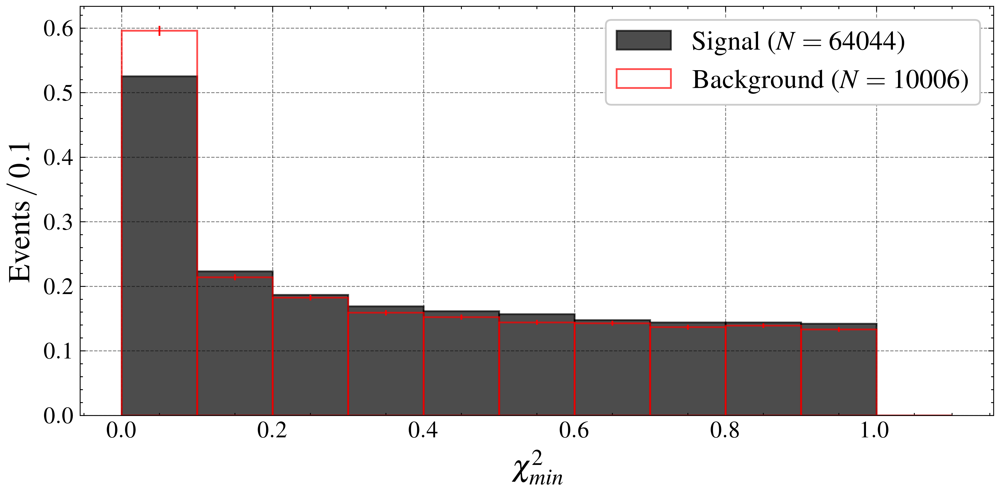

In [29]:
wbin = 0.1
a = 0
b = 1.1
bins = np.linspace(a, b, int((b-a)/wbin + 1))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))


bin_centers_sig, counts_sig1, N_sig1 = compute_histogram(
    sig, bins, "Chi_sq_0",
    filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1) & (pc.field("p_tau_0") < pc.field("p_tau_1")),
    norm=True, nanto=-1
) 
bin_centers_sig, counts_sig2, N_sig2 =compute_histogram(
    sig, bins, "Chi_sq_1",
    filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1) & (pc.field("p_tau_1") < pc.field("p_tau_0")),
    norm=True, nanto=-1
)
ax.bar(
    bin_centers_sig, counts_sig1+counts_sig2,
    width=wbin, align='center',
    alpha=0.7, linewidth=1,
    edgecolor=colors[0], color=colors[0], ecolor=colors[0],
    label=f"Signal ($N = {N_sig1+N_sig2}$)",
)

bin_centers_lep, counts_lep1, N_lep1 = compute_histogram(
    lep, bins, "Chi_sq_0",
    filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1) & (pc.field("p_tau_0") < pc.field("p_tau_1")),
    norm=True, nanto=-1
) 
bin_centers_lep, counts_lep2, N_lep2 = compute_histogram(
    lep, bins, "Chi_sq_1",
    filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1) & (pc.field("p_tau_1") < pc.field("p_tau_0")),
    norm=True, nanto=-1
)
ax.bar(
    bin_centers_lep, counts_lep1+counts_lep2,
    yerr=np.sqrt(counts_lep1+counts_lep2)/np.sqrt(N_lep1+N_lep2),
    width=wbin, align='center',
    fill = False, alpha = 0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep1+N_lep2}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$\chi^2_{min}$')
ax.legend()

plt.tight_layout()
plt.show()


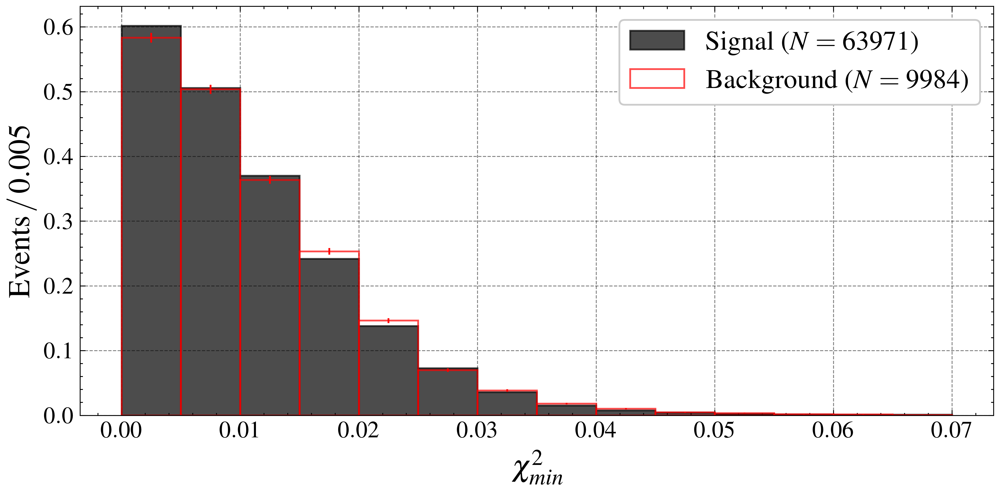

In [30]:
wbin = 0.005
a = 0
b = 0.07
bins = np.linspace(a, b, int((b-a)/wbin + 1))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))


bin_centers_sig, counts_sig1, N_sig1 = compute_histogram(
    sig, bins, "dr0",
    filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1) & (pc.field("p_tau_0") < pc.field("p_tau_1")),
    norm=True, nanto=-1
) 
bin_centers_sig, counts_sig2, N_sig2 =compute_histogram(
    sig, bins, "dr1",
    filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1) & (pc.field("p_tau_1") < pc.field("p_tau_0")),
    norm=True, nanto=-1
)
ax.bar(
    bin_centers_sig, counts_sig1+counts_sig2,
    width=wbin, align='center',
    alpha=0.7, linewidth=1,
    edgecolor=colors[0], color=colors[0], ecolor=colors[0],
    label=f"Signal ($N = {N_sig1+N_sig2}$)",
)

bin_centers_lep, counts_lep1, N_lep1 = compute_histogram(
    lep, bins, "dr0",
    filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1) & (pc.field("p_tau_0") < pc.field("p_tau_1")),
    norm=True, nanto=-1
) 
bin_centers_lep, counts_lep2, N_lep2 = compute_histogram(
    lep, bins, "dr1",
    filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1) & (pc.field("p_tau_1") < pc.field("p_tau_0")),
    norm=True, nanto=-1
)
ax.bar(
    bin_centers_lep, counts_lep1+counts_lep2,
    yerr=np.sqrt(counts_lep1+counts_lep2)/np.sqrt(N_lep1+N_lep2),
    width=wbin, align='center',
    fill = False, alpha = 0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep1+N_lep2}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$\chi^2_{min}$')
ax.legend()

plt.tight_layout()
plt.show()


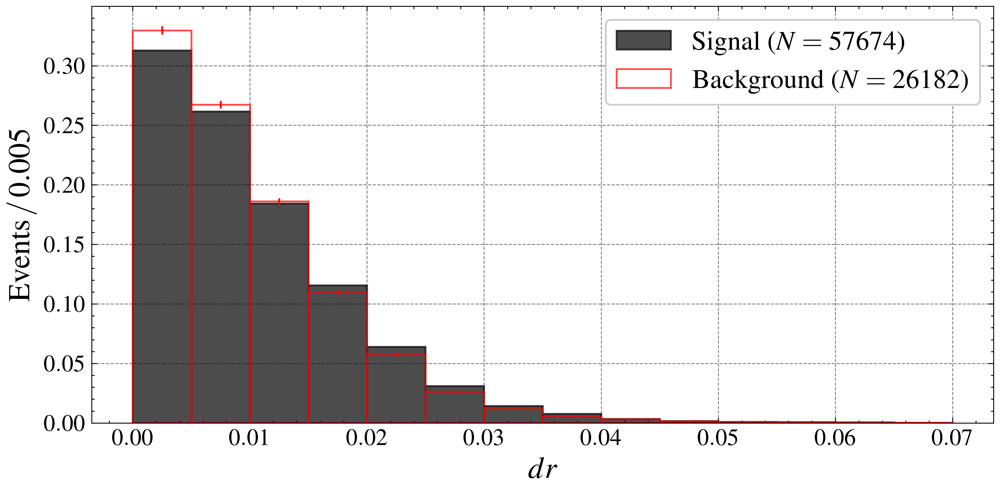

In [31]:
wbin = 0.005
a = 0
b = 0.07
bins = np.linspace(a, b, int((b-a)/wbin + 1))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))


bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, "dr0",
    filter_mask=(mask_lep & (pc.field("is0") == 1) & (pc.field("p_tau_0") > pc.field("p_tau_1"))),
    norm=True, nanto=-1
) 
ax.bar(
    bin_centers_sig, counts_sig,
    width=wbin, align='center',
    alpha=0.7, linewidth=1,
    edgecolor=colors[0], color=colors[0], ecolor=colors[0],
    label=f"Signal ($N = {N_sig}$)",
)

bin_centers_bsbs, counts_bsbs, N_bsbs = compute_histogram(
    lep, bins, "dr0",
    filter_mask=(mask_lep & (pc.field("is0") == 1) & (pc.field("p_tau_0") > pc.field("p_tau_1"))),
    norm=True, nanto=-1
) 
ax.bar(
    bin_centers_bsbs, counts_bsbs,
    yerr=np.sqrt(counts_bsbs)/np.sqrt(N_bsbs),
    width=wbin, align='center',
    fill = False, alpha = 0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_bsbs}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$dr$')
ax.legend()

plt.tight_layout()
plt.show()


KeyError: "None of [Index(['dr1'], dtype='object')] are in the [columns]"

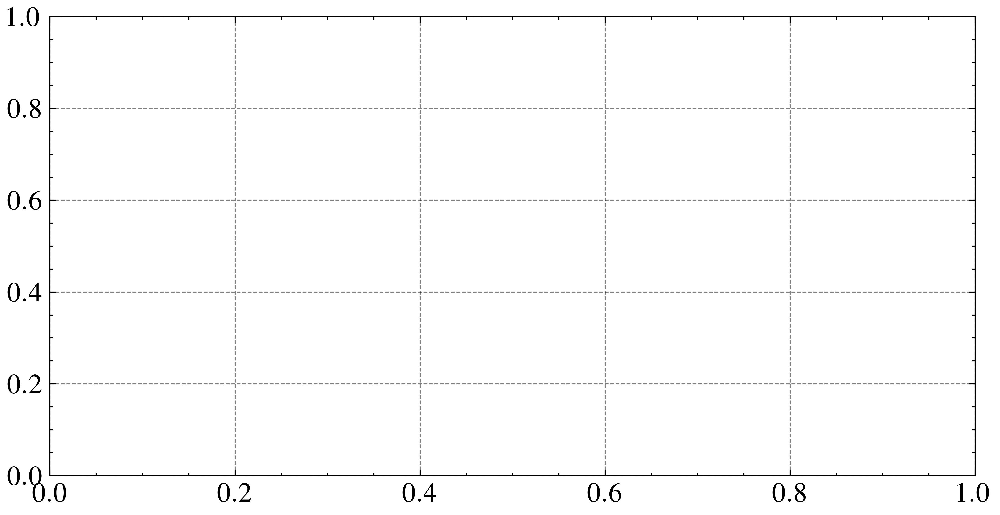

In [32]:
wbin = 0.15
a = -1
b = 1
bins = np.linspace(a, b, int((b - a) / wbin + 1))

fig, ax = plt.subplots(1, figsize=(12 / 1.5, 6 / 1.5))

# функция выбора угла с наиболее энергичным лептоном
def select_max_energy_angle(df):
    return pd.DataFrame({
        "cos_angle": np.where(
            df["p_tau_0"] > df["p_tau_1"],
            df["ang_tau1_pmiss"],
            df["ang_tau0_pmiss"]
        )
    })

# Signal
bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, target="dr1",
    fun=select_max_energy_angle,
    filter_mask=mask_sig,
    norm=False
)
errordot(counts_sig, bins=bins, density=True,
         color=colors[0], label=f"Signal ($N = {N_sig}$)", axs=ax)

# Background
bin_centers_lep, counts_lep, N_lep = compute_histogram(
    lep, bins, target="dr1",
    fun=select_max_energy_angle,
    filter_mask=mask_bkg,
    norm=True
)
ax.bar(
    bin_centers_lep, counts_lep,
    yerr=np.sqrt(counts_lep) / np.sqrt(N_lep),
    width=wbin, align='center',
    fill=False, alpha=0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_lep}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$dr1$')
ax.legend()
plt.tight_layout()
plt.show()


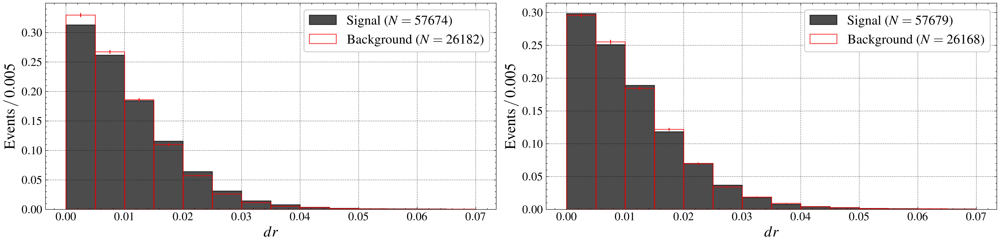

In [ ]:
fig, ax = plt.subplots(1, figsize=(12 / 1.5, 6 / 1.5))

bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, target="Delta_tau0_Btag",
    filter_mask=mask_sig,
    norm=False
)
errordot(counts_sig, bins=bins, density=True,
         color=colors[0], label=f"Signal ($N = {N_sig}$)", axs=ax)

bin_centers_bkg, counts_bkg, N_bkg = compute_histogram(
    lep, bins, target="Delta_tau0_Btag",
    filter_mask=mask_bkg,
    norm=True
)
ax.bar(
    bin_centers_bkg, counts_bkg,
    yerr=np.sqrt(counts_bkg) / np.sqrt(N_bkg),
    width=wbin, align='center',
    fill=False, alpha=0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_bkg}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}\\ \\mathrm{{cm}}$')
ax.set_xlabel(r'$\Delta z(\tau_0, B_\mathrm{tag})\ \mathrm{[cm]}$')
ax.legend()
plt.tight_layout()
plt.show()


KeyError: "None of [Index([('dr0', 'dr1')], dtype='object')] are in the [index]"

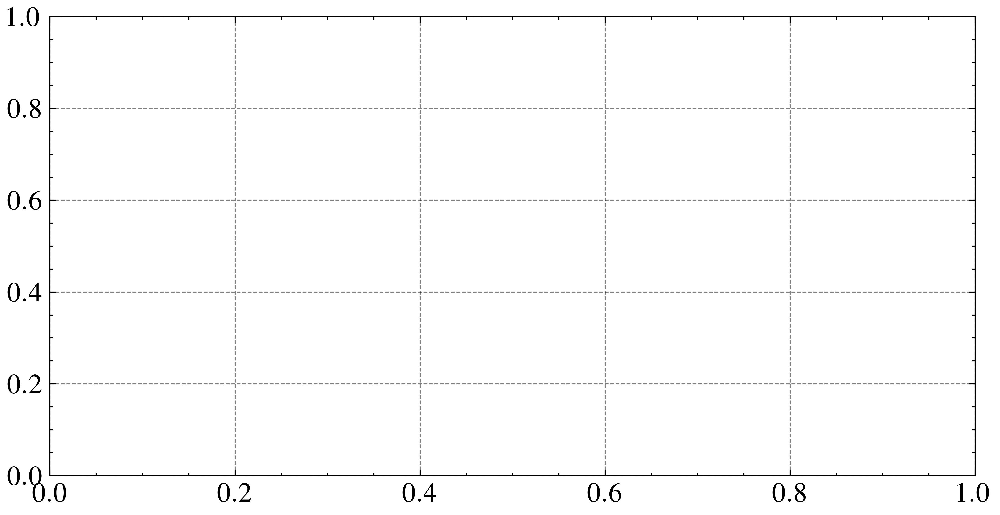

In [ ]:
wbin = 0.005
a = 0
b = 0.07
bins = np.linspace(a, b, int((b-a)//wbin + 1))

fig, ax = plt.subplots(1, figsize=(12/1.5, 6/1.5))


bin_centers_sig, counts_sig, N_sig = compute_histogram(
    sig, bins, ["dr0", "dr1"], fun=lambda x: np.max(x,axis=0),
    filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1),
    norm=True, nanto=-1
) 
ax.bar(
    bin_centers_sig, counts_sig,
    width=wbin, align='center',
    alpha=0.7, linewidth=1,
    edgecolor=colors[0], color=colors[0], ecolor=colors[0],
    label=f"Signal ($N = {N_sig}$)",
)

bin_centers_bsbs, counts_bsbs, N_bsbs = compute_histogram(
    lep, bins, ["dr0", "dr1"], fun=lambda x: np.max(x,axis=0),
    filter_mask=((pc.field("E_gamma_in_ROE") < 0.2)) & mask_lep & (pc.field("is0") == 1),
    norm=True, nanto=-1
) 
ax.bar(
    bin_centers_bsbs, counts_bsbs,
    yerr=np.sqrt(counts_bsbs)/np.sqrt(N_bsbs),
    width=wbin, align='center',
    fill = False, alpha = 0.7, linewidth=1,
    edgecolor=colors[1], color=colors[1], ecolor=colors[1],
    label=f"Background ($N = {N_bsbs}$)"
)

ax.set_ylabel(f'$\\mathrm{{Events}}\\,/\\,{wbin}$')
ax.set_xlabel(r'$dr$')
ax.legend()

plt.tight_layout()
plt.show()


In [ ]:
from pathlib import Path
import pyarrow as pa
import pyarrow.parquet as pq
import pandas as pd
import numpy as np

def add_cos_angle_features(df: pd.DataFrame) -> pd.DataFrame:
    df["cos_angle_max"] = np.where(
        df["p_tau_0"] > df["p_tau_1"],
        df["ang_tau0_pmiss"],
        df["ang_tau1_pmiss"]
    )
    df["cos_angle_min"] = np.where(
        df["p_tau_0"] > df["p_tau_1"],
        df["ang_tau1_pmiss"],
        df["ang_tau0_pmiss"]
    )
    return df

def process_parquet_folder(folder_path: str):
    folder = Path(folder_path)
    for file in folder.glob("*.parquet"):
        print(f"Processing: {file.name}")
        table = pq.read_table(file)
        df = table.to_pandas()

        # Добавляем новые признаки
        df = add_cos_angle_features(df)

        # Сохраняем обратно
        new_table = pa.Table.from_pandas(df, preserve_index=False)
        pq.write_table(new_table, file)

# Применим к обеим папкам
process_parquet_folder("new_sig/")
process_parquet_folder("halfleptonic/")
